# Warehouse Simulation Model

Simulates the process of organizing items in a warehouse.

## Information

### Course Overview

- Institute: [Tecnológico de Monterrey](https://tec.mx/en)
- Course: H2C2008B.301 - Modelacion de Sistemas Multiagentes con Gráficas Computacionales
- Professor: Peter
- Author: [Carlos Salguero](https://github.com/salgue441)
- Semester: August - December 2023
- Date: 2023-11-16

## Assignment

### Description

Congratulations! You are the proud owner of 5 new robots and a warehouse full of boxes. The previous owner left the warehouse in complete disarray, so it's up to your robots to organize the boxes into some semblance of order and turn it into a successful business.

Each robot is equipped with omnidirectional wheels and can therefore drive in all four directions. They can pick up boxes in adjacent grid cells with their manipulators, then carry them to another location and even build stacks of up to five boxes. All robots are equipped with the latest sensor technology that allows them to receive sensor data from the four adjacent cells. Therefore, it is easy to distinguish if a field is free, is a wall, contains a stack of boxes (and how many boxes are in the stack), or is occupied by another robot. The robots also have pressure sensors equipped that indicate if they are currently carrying a box.

Unfortunately, your budget was insufficient to acquire cutting-edge multi-agent management software. But that shouldn't be a big problem... right? Your task is to teach your robots how to sort your warehouse. The organization of the agents is up to you, as long as all the boxes end up in neat stacks of five.

### Requirements

- The seed for random number generation will be 67890.
- The warehouse is 20x20 cells.
- At the start of the simulation, your solution must place 200 boxes distributed in groups of 1 to 3 boxes in random positions.
- All robots start in random empty positions. And, there can only be one robot per cell.
- The simulation ends when all the boxes are stacked in piles of exactly 5 boxes.


In [10]:
from mesa import Agent, Model
from mesa.space import SingleGrid
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector

import pandas as pd
import numpy as np

# Manhatan Distance Formula

## Description

The function calculates the Manhattan distance, which is a metric for the distance between two points in a grid-based path planning. It adds up the absolute differences of their X and Y coordinates, effectively measuring along axes at right angles.

The Manhattan distance is mathematically expressed as:

$$
Manhattan Distance = |x_1 - x_2| + |y_1 - y_2|
$$

Where `x_1` and `y_1` are the coordinates of the first point, and `x_2` and `y_2` are the coordinates of the second point.

## Parameters

- `x_1`: The x coordinate of the first point
- `y_1`: The y coordinate of the first point
- `x_2`: The x coordinate of the second point
- `y_2`: The y coordinate of the second point

## Returns

- `distance`: The manhatan distance between the two points


In [11]:
def manhattan_distance(pos1: tuple[int, int], pos2: tuple[int, int]) -> int:
    """
    Compute the manhattan distance between two points.

    Args:
        pos1: First point.
        pos2: Second point.

    Returns:
        The manhattan distance between the two points.
    """

    return abs(pos1[0] - pos2[0]) + abs(pos1[1] - pos2[1])

# RobotStates Enumerated Type

## Description

The enumerated type `RobotStates` is used to represent the state of a robot. It can be either `EXPLORING`, `COLLECTING`, or `STACKING`.

## Values

- `EXPLORING`: The robot is exploring the warehouse
- `COLLECTING`: The robot is collecting a box
- `STACKING`: The robot is stacking a box


In [12]:
from enum import Enum


class RobotStates(Enum):
    """
    Possible states of a robot.
    """

    EXPLORING = 0
    COLLECTING = 1
    STACKING = 2

## Robot Class

The `Robot` class is an agent in a simulation that is designed to explore, collect, and stack boxes in a grid-based environment. This class inherits from the `Agent` class and implements the behavior of the robot.

### Class Attributes

- `__slots__`: A list of attributes that the robot class uses for optimization.
- `allowed_transitions`: A dictionary that defines the allowed state transitions for the robot.

### Methods

- `__init__`: The constructor of the robot class. It initializes the robot's attributes.
- `current_state`: A property that returns the current state of the robot.
- `current_state`: A property that sets the current state of the robot.
- `is_valid_transition`: A method that checks if a transition between two states is valid.
- `explore`: A method that simulates the robot exploring the warehouse.
- `get_neighborhood`: A method that returns the neighborhood of the robot.
- `collect_box`: A method that simulates the robot collecting a box.
- `stack_box`: A method that simulates the robot stacking a box.
- `find_stacks`: A method that finds the stacks in the warehouse environment (either smallest or largest).
- `move`: A method that moves the robot to a new position in the warehouse environment.
- `get_random_position`: A method that returns a random position in the warehouse environment.
- `get_possible_move`: A method that returns the possible moves of the robot.
- `scan_grid`: A method that scans the warehouse environment for boxes.
- `step`: A method that simulates the robot taking a step in the simulation.

## Strategy Overview

**State-Driven Behavior**: Each robot's behavior is driven by its current state, which can be one of three: exploring, collecting, or stacking. This state-based design allows for complex, adaptive behaviors that are responsive to the environment.

## Mechanisms Employed

1. **Exploration and Target Identification**: Robots navigate the warehouse to identify stacks of boxes, distinguishing between smaller and larger stacks. Their choice to target the smallest or largest stack depends on their current objective, alternating between collecting and stacking phases.

2. **Box Collection**: Robots are programmed to collect boxes within their immediate vicinity. They are restricted to carrying only one box at a time, introducing a realistic challenge to their operational capabilities.

3. **Adaptive Behavior**: The robots adapt their behavior according to their current state. During exploration, they move randomly. In the collecting state, they seek the nearest box. While stacking, they prioritize the closest stack. If appropriate stacks are not available, the robots revert to exploration, showcasing their ability to adjust to varying circumstances.

4. **Movement**: The robots' movement is purpose-driven, either targeting specific locations or moving randomly based on their objectives. They utilize the Manhattan distance metric to make movement decisions, striving for efficiency and reduced travel time.

5. **Environmental Awareness**: Robots scan their surroundings to update their understanding of the warehouse layout. This information is crucial for making informed decisions about their next actions.


In [13]:
class Robot(Agent):
    __slots__ = ["carrying_box", "_current_state", "last_box"]

    allowed_transitions = {
        RobotStates.EXPLORING: [RobotStates.COLLECTING, RobotStates.STACKING],
        RobotStates.COLLECTING: [RobotStates.STACKING, RobotStates.EXPLORING],
        RobotStates.STACKING: [RobotStates.EXPLORING],
    }

    def __init__(self, unique_id: int, model: Model) -> None:
        """
        Initializes a robot agent. The agent has a current_state that can be either
        "exploring", "collecting" or "stacking". The agent also has a variable
        that indicates whether it is carrying a box or not.
        """

        super().__init__(unique_id, model)

        self.random.seed(67890)
        self.carrying_box = False
        self._current_state = RobotStates.EXPLORING
        self.last_box = None

    @property
    def current_state(self) -> RobotStates:
        """
        Returns the current state of the agent.
        """

        return self._current_state

    @current_state.setter
    def current_state(self, state: RobotStates) -> None:
        if self.is_valid_transition(state):
            self._current_state = state
        else:
            raise ValueError(
                f"Invalid state transition from {self._current_state} to {state}"
            )

    def is_valid_transition(self, new_state) -> bool:
        """
        Checks if the transition from the current state to the new state is valid.

        Args:
            new_state: The new state to transition to.

        Returns:
            True if the transition is valid, False otherwise.
        """

        return new_state in self.allowed_transitions[self._current_state]

    def explore(self) -> None:
        """
        Explores the grid searching for the smallest stack_box of boxes.
        """

        if self.find_stacks(find_smallest=True):
            self.current_state = RobotStates.COLLECTING
            self.collect_box()

        else:
            self.move(None)

    def get_neighborhood(self, moore: bool = True) -> list[tuple[int, int]]:
        """
        Returns the neighborhood of the agent.

        Args:
            moore: Whether to use Moore neighborhood or not.

        Returns:
            A list of tuples with the coordinates of the neighborhood.
        """

        return self.model.grid.get_neighborhood(
            self.pos, moore=moore, include_center=False
        )

    def collect_box(self) -> None:
        """
        Collects the box from the smallest stack_box of boxes.
        """

        smallest = {tuple(x) for x in self.find_stacks(find_smallest=True)}
        smallest.discard(self.last_box)

        if not smallest:
            self.current_state = RobotStates.EXPLORING
            self.move(None)
            return

        nearest_box = min(smallest, key=lambda x: manhattan_distance(x, self.pos))

        if nearest_box in self.get_neighborhood(moore=False):
            self.carrying_box = True
            self.model.boxes_grid[nearest_box[0]][nearest_box[1]] -= 1
            self.model.known_boxes[nearest_box[0]][nearest_box[1]] -= 1
            self.current_state = RobotStates.STACKING
            self.stack_box()

        else:
            self.move(nearest_box)

    def stack_box(self) -> None:
        """
        Stacks the box on the biggest stack_box of boxes.
        """

        if not self.carrying_box:
            self.current_state = RobotStates.EXPLORING
            self.explore()
            return

        largest = {tuple(x) for x in self.find_stacks(find_smallest=False)}

        if not largest:
            self.move(None)
            return

        nearest_stack = min(
            largest, key=lambda x: manhattan_distance(x, self.pos), default=None
        )

        if nearest_stack is None:
            self.move(None)
            return

        if nearest_stack in self.get_neighborhood(moore=False):
            self.model.boxes_grid[nearest_stack[0]][nearest_stack[1]] += 1
            self.model.known_boxes[nearest_stack[0]][nearest_stack[1]] += 1

            self.carrying_box = False
            self.current_state = RobotStates.EXPLORING
            self.last_box = nearest_stack
            self.explore()

        else:
            self.move(nearest_stack)

    def find_stacks(self, find_smallest=True) -> list[tuple[int, int]]:
        """
        Finds the smallest or largest stack_box of boxes in the grid using
        the known_boxes grid.

        Args:
            find_smallest: Whether to find the smallest or largest stack_box of boxes.

        Returns:
            A list of tuples with the coordinates of the smallest or largest stack_box of boxes.
        """
        grid = self.model.known_boxes
        valid_cells = np.where((grid > 0) & (grid < MAX_STACK_SIZE))

        if valid_cells[0].size == 0:
            return []

        if find_smallest:
            extreme_value = np.min(grid[valid_cells])

        else:
            extreme_value = np.max(grid[valid_cells])

        return np.column_stack(np.where(grid == extreme_value)).tolist()

    def move(self, cell: tuple[int, int]) -> None:
        """
        Moves to the given cell if it is not None, otherwise moves to a random
        cell.
        """

        if cell is None:
            cell = self.get_random_position()

            if cell is None:
                return

        closest_move = min(
            self.get_possible_move(),
            key=lambda x: manhattan_distance(x, cell),
            default=None,
        )

        if closest_move:
            self.model.grid.move_agent(self, closest_move)

    def get_random_position(self) -> tuple[int, int]:
        """
        Returns a random cell to move to.
        """

        return self.random.choice(self.get_possible_move())

    def get_possible_move(self) -> list[tuple[int, int]]:
        """
        Returns a list of possible cells to move to.
        """

        return [
            cell
            for cell in self.get_neighborhood(moore=False)
            if self.model.grid.is_cell_empty(cell)
        ]

    def scan_grid(self) -> None:
        """
        Scans the grid to find the smallest stack_box of boxes.
        """

        neighbors = self.get_neighborhood(moore=False)

        for x, y in neighbors:
            self.model.known_boxes[x][y] = self.model.boxes_grid[x][y]

    def step(self) -> None:
        """
        Executes one step of the agent.
        """

        self.scan_grid()

        if self.current_state == RobotStates.STACKING:
            self.stack_box()

        elif self.current_state == RobotStates.COLLECTING:
            self.collect_box()

        else:
            self.explore()

# Warehouse Simulation Model

The Warehouse class is a simulation model that represents a warehouse environment with agents and boxes. It is designed to simulate the process of organizing boxes in a warehouse.

## Attributes

- `random`: The random number generator
- `grid`: The grid representing the warehouse environment
- `schedule`: The schedule for the simulation
- `running`: A boolean value indicating whether the simulation is running or not
- `stack_box`: A list of box stacks in the warehouse
- `num_stacks`: The number of stacks in the warehouse
- `boxes_grid`: A grid representing the boxes in the warehouse
- `known_boxes`: A list of known boxes in the warehouse
- `datacollector`: The data collector for the simulation

## Methods

- `__init__`: The constructor method for the Warehouse class
- `place_boxes`: Places boxes in the warehouse
- `place_agents`: Places robots in the warehouse
- `get_random_empty_cell`: Gets a random empty cell in the warehouse
- `get_known_boxes`: Gets the known boxes in the warehouse
- `get_boxes_grid`: Gets the grid representing the boxes in the warehouse
- `get_agents`: Gets the robots in the warehouse
- `step`: The step behavior for the simulation


In [14]:
class Warehouse(Model):
    __slots__ = [
        "grid",
        "schedule",
        "running",
        "stack_box",
        "num_stacks",
        "boxes_grid",
        "known_boxes",
        "datacollector",
    ]

    def __init__(
        self, width: int, height: int, num_agents=5, num_boxes=200, max_stack_size=5
    ) -> None:
        """
        Initializes the model with the given parameters. Sets the random seed
        to 67890. Creates the different layers of the model.
        """

        self.random.seed(67890)
        self.grid = SingleGrid(width, height, torus=False)
        self.schedule = RandomActivation(self)
        self.running = True

        self.stack_box = 0
        self.num_stacks = num_boxes // max_stack_size

        # Layers
        self.boxes_grid = np.zeros((width, height), dtype=np.int8)
        self.known_boxes = np.zeros((width, height), dtype=np.int8)

        # Initialization
        self.place_boxes(num_boxes, max_stack_size)
        self.place_agents(num_agents)

        # Data collection
        self.datacollector = DataCollector(
            model_reporters={
                "known_boxes": self.get_know_boxes,
                "boxes_grid": self.get_boxes_grid,
                "agents": self.get_agents,
            }
        )

    def place_boxes(self, num_boxes: int, max_stack_size: int) -> None:
        """
        Places the boxes randomly on the grid.
        """

        placed_boxes = 0

        while placed_boxes < num_boxes:
            x, y = self.get_random_empty_cell()

            stack_size = min(
                self.random.randint(1, MAX_STACK_SPAWN_HEIGHT), num_boxes - placed_boxes
            )

            self.boxes_grid[x][y] += stack_size
            placed_boxes += stack_size

    def place_agents(self, num_agents: int) -> None:
        """
        Places the agents randomly on the grid.
        """

        for i in range(num_agents):
            agent = Robot(i, self)
            self.schedule.add(agent)

            x, y = self.get_random_empty_cell()
            self.grid.place_agent(agent, (x, y))

    def get_random_empty_cell(self) -> tuple[int, int]:
        """
        Returns a random empty cell.
        """

        while True:
            x, y = self.random.randrange(self.grid.width), self.random.randrange(
                self.grid.height
            )

            if self.grid.is_cell_empty((x, y)) and self.boxes_grid[x][y] == 0:
                return x, y

    def get_know_boxes(self) -> np.ndarray:
        """
        Returns the known_boxes layer.
        """

        return self.known_boxes.copy()

    def get_boxes_grid(self) -> np.ndarray:
        """
        Returns the boxes_grid layer.
        """

        return self.boxes_grid.copy()

    def get_agents(self) -> list[Robot]:
        """
        Returns the list of agents.
        """

        grid = np.full((self.grid.width, self.grid.height), False, dtype=bool)

        for content, (x, y) in self.grid.coord_iter():
            if content is not None:
                grid[x][y] = True

        return grid

    def step(self) -> None:
        """
        Steps the model.
        """

        self.datacollector.collect(self)
        self.schedule.step()

        mask = self.boxes_grid >= 5
        self.stack_box = np.count_nonzero(mask)

        if self.stack_box >= self.num_stacks:
            self.running = False

# Simulation Parameters

Allows configuration of the simulation parameters.

## Parameters

- **Grid Size**: The size of the grid in which the simulation will take place. The grid is a square, so only one value is needed.
- **Number of Robots**: The number of robots that will be in the simulation.
- **Number of Boxes**: The number of boxes that will be in the simulation.


In [15]:
GRID_SIZE = 20
NUM_AGENTS = 5
NUM_BOXES = 200
MAX_STACK_SIZE = 5
MAX_STACK_SPAWN_HEIGHT = 3

# Simulation Results


In [16]:
%matplotlib inline

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib import animation
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

def plot_warehouse(boxes_grid: list[list[int]], title: str, figsize=(10, 10), cmap="Greys"):
    """
    Plots the warehouse.

    Args:
        boxes_grid: The boxes_grid layer.
        title: The title of the plot.
        figsize: The size of the figure.
        cmap: The color map to use.
    """

    data = np.array([[cell if cell else 0 for cell in row] for row in boxes_grid])

    plt.figure(figsize=figsize)
    heatmap = plt.imshow(data, cmap=cmap)

    for i in range(len(boxes_grid)):
        for j in range(len(boxes_grid[0])):
            text_color = "black" if data[i, j] < data.max() / 2 else "white"
            plt.text(j, i, data[i, j], ha="center", va="center", color=text_color)

    plt.colorbar(heatmap)

    plt.title(title)
    plt.xlabel("Aisle")
    plt.ylabel("Shelf")

    ax = plt.gca()
    ax.set_xticklabels([])
    ax.set_yticklabels([])

    plt.show()

def animate_warehouse(warehouse, frames):
    """
    Animates the warehouse simulation with robots as blue dots and box counts.

    Args:
        warehouse: The Warehouse model instance.
        frames: The number of frames to animate.
    """

    fig, ax = plt.subplots(figsize=(10, 10))
    plt.close()

    ax.set_xticks(np.arange(-.5, warehouse.grid.width, 1), minor=True)
    ax.set_yticks(np.arange(-.5, warehouse.grid.height, 1), minor=True)

    ax.tick_params(axis='both', which='both', length=0)

    ax.set_title("Warehouse Simulation")
    ax.set_xlabel("Aisle")
    ax.set_ylabel("Shelf")

    box_grid = warehouse.get_boxes_grid()
    im = ax.imshow(box_grid, cmap='Greys', vmin=0, vmax=5)

    text_annot = np.full_like(box_grid, None, dtype=object)
    for (x, y), val in np.ndenumerate(box_grid):

        if val > 0:  
            text_annot[x, y] = ax.text(y, x, str(val), ha='center', va='center', color='red')

    agent_grid = warehouse.get_agents()
    agent_x, agent_y = np.where(agent_grid)
    robots = ax.scatter(agent_y, agent_x, color='blue', s=50, label='Robots')  

    ax.legend(loc='upper left')

    def update(frame):
        warehouse.step()
        
        box_grid = warehouse.get_boxes_grid()
        im.set_data(box_grid)

        for (x, y), val in np.ndenumerate(box_grid):
            text = text_annot[x, y]

            if text is not None: 
                text.set_text(str(val) if val > 0 else '')
                text.set_visible(True)

            else:
                text_annot[x, y] = ax.text(y, x, '', ha='center', va='center', color='red')

        agent_grid = warehouse.get_agents()
        agent_x, agent_y = np.where(agent_grid)
        robots.set_offsets(np.column_stack([agent_y, agent_x]))

        return [im, robots, *np.array([ta if ta is not None else ax.text(0, 0, '', visible=False) for ta in text_annot.flatten()])]

    return animation.FuncAnimation(fig, update, frames=frames, interval=200, blit=True)


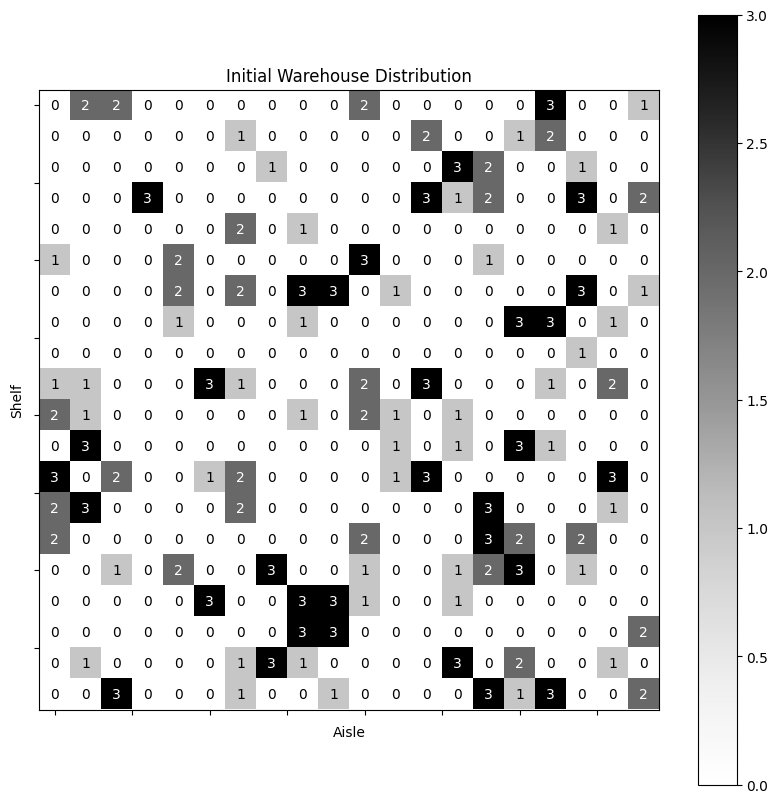

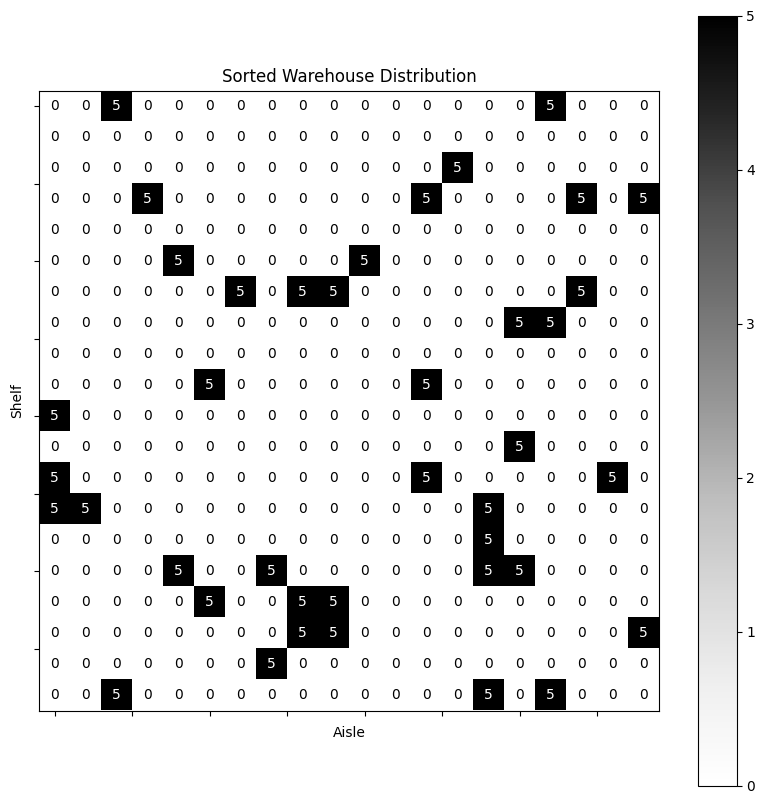

In 656 steps, the simulation ended with 40 stack_box of 5 boxes.


In [17]:
def run_simulation() -> Model:
    """
    Runs the simulation

    Returns:
        The model after running the simulation.
    """

    model = Warehouse(
        GRID_SIZE, GRID_SIZE, num_agents=5, num_boxes=200, max_stack_size=5
    )

    plot_warehouse(model.boxes_grid, "Initial Warehouse Distribution")

    while model.running:
        model.step()

    return model


model = run_simulation()
plot_warehouse(model.boxes_grid, "Sorted Warehouse Distribution")

print(
    f"In {model.schedule.steps} steps, the simulation ended with {model.stack_box} stack_box of 5 boxes."
)

In [18]:
warehouse_model = Warehouse(
    GRID_SIZE,
    GRID_SIZE,
    num_agents=NUM_AGENTS,
    num_boxes=NUM_BOXES,
    max_stack_size=MAX_STACK_SIZE,
)

anim = animate_warehouse(warehouse_model, 656)

anim

# Observations and Conclusions

## Movement Strategies of Robots

- **Inefficient Paths in Collecting and Stacking Phases**: During the collecting and stacking phases, the robots choose their paths based on the nearest box or stack, calculated using Manhattan Distance. However, this metric is a simple heuristic that does not always result in the most direct path, as it ignores potential obstacles and more efficient alternatives. This tendency can lead to extra, unnecessary steps, as observed in the simulation outcomes.

- **Limited Awareness of Surroundings**: Robots currently base their movement decisions on the immediate vicinity and their knowledge of box locations, lacking a comprehensive understanding of the entire warehouse environment. This narrow perspective is noticeable in their explore, collect_box, and stack_box behaviors. Their decision-making process focuses on nearby or known locations, which may not always be the most strategic or efficient choice.

- **Enhancements through Advanced Pathfinding**: To overcome these limitations in the robots' navigation strategy, the integration of advanced pathfinding algorithms, such as A\* or Dijkstra's algorithm, is proposed. By adopting these algorithms, robots would be equipped to determine the shortest and most efficient routes to their destinations. This improvement is expected to minimize redundant movements and enhance the overall efficiency of the sorting process in the warehouse.

## Conclusion

In conclusion, the analysis of the movement strategies employed by the robots in the warehouse reveals notable inefficiencies in path selection during the collecting and stacking phases. The reliance on the simplistic Manhattan Distance metric and the limited awareness of the surroundings contribute to suboptimal decision-making, resulting in unnecessary steps and potentially prolonged sorting times.

Personally, the process of creating and analyzing this simulation was a rewarding challenge that prompted me to consider diverse movement strategies and their dynamic interactions with the environment. During the experimentation phase, a random movement strategy was initially employed, resulting in a simulation with up to 124,000 steps. Recognizing the suboptimality of this approach, I embraced a continuous improvement mindset, leading to the implementation of a state-machine approach. Through meticulous evaluation and refinement of the robots' movement strategies, the number of steps was successfully reduced to 656—a remarkable 99.5% improvement.

Overall, this project has been a valuable learning experience that has deepened my understanding of multi-agent systems and their applications in real-world scenarios.